In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
from cycler import cycler
from matplotlib import animation
from IPython.display import Image, HTML

sns.set_theme( style = 'whitegrid')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.rcParams['axes.prop_cycle'] = cycler(color=['midnightblue', 'magenta', 'yellowgreen', 'crimson', 'dodgerblue', 'violet'])

# 1. Test stabilności

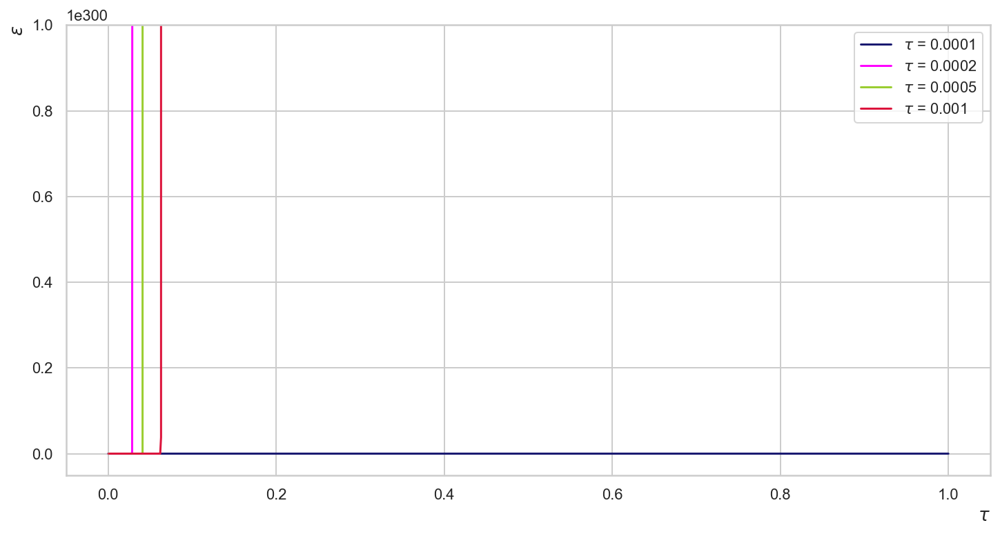

In [33]:
df001 = pd.read_csv("out/out_dt001.txt", sep='\t', header=0, index_col=False)
df0005 = pd.read_csv("out/out_dt0005.txt", sep='\t', header=0, index_col=False)
df0002 = pd.read_csv("out/out_dt0002.txt", sep='\t', header=0, index_col=False)
df0001 = pd.read_csv("out/out_dt0001.txt", sep='\t', header=0, index_col=False)

fig = plt.figure(figsize = (12, 6))
plt.plot(df0001['t'], df0001['E'], label = r'$\tau$ = 0.0001')
plt.plot(df0002['t'], df0002['E'], label = r'$\tau$ = 0.0002')
plt.plot(df0005['t'], df0005['E'], label = r'$\tau$ = 0.0005')
plt.plot(df001['t'], df001['E'], label = r'$\tau$ = 0.001')
plt.ylim(-0.05e300, 1e300)
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel(r'$\epsilon$', fontsize=13, loc='top')
_ = plt.legend()
plt.savefig("./fig/stabilnosc.pdf")

Analizując zachowanie energii przy wyłączonym polu elektrycznym dla n=1 ustalono krok czasowy symulacji $d\tau$ = 0.0001. Dla większych kroków algorytm był niestabilny.

# 2. Test algorytmu
Zachowanie normy, położenia średniego i energii dla n = 1,4,9 przy wyłączonym polu elektrycznym

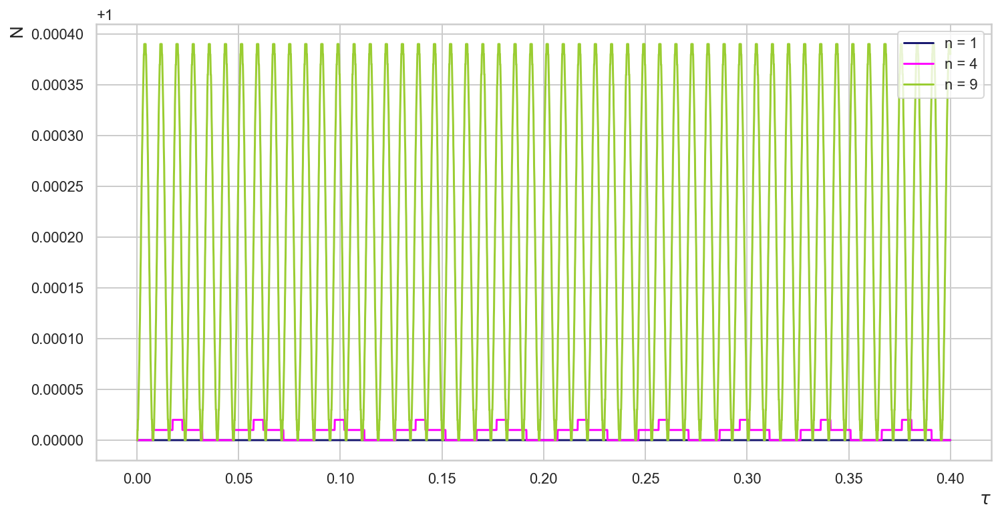

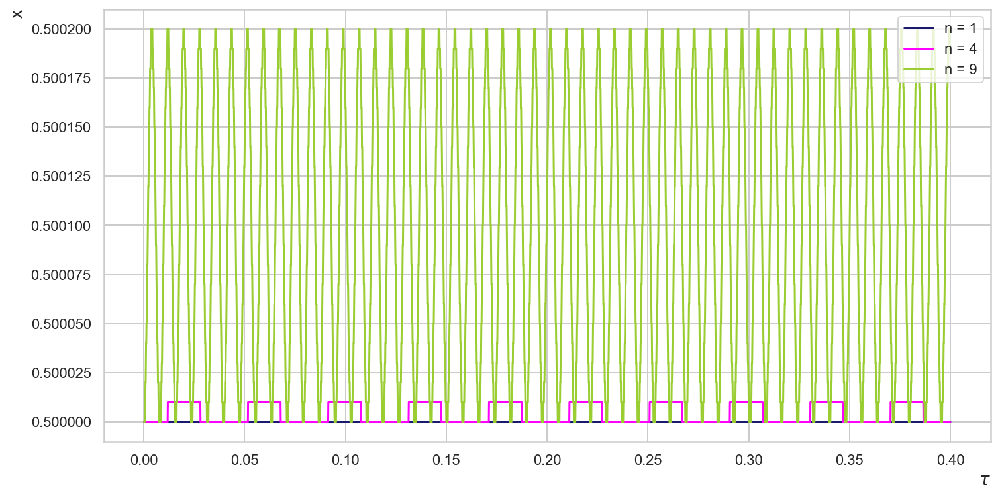

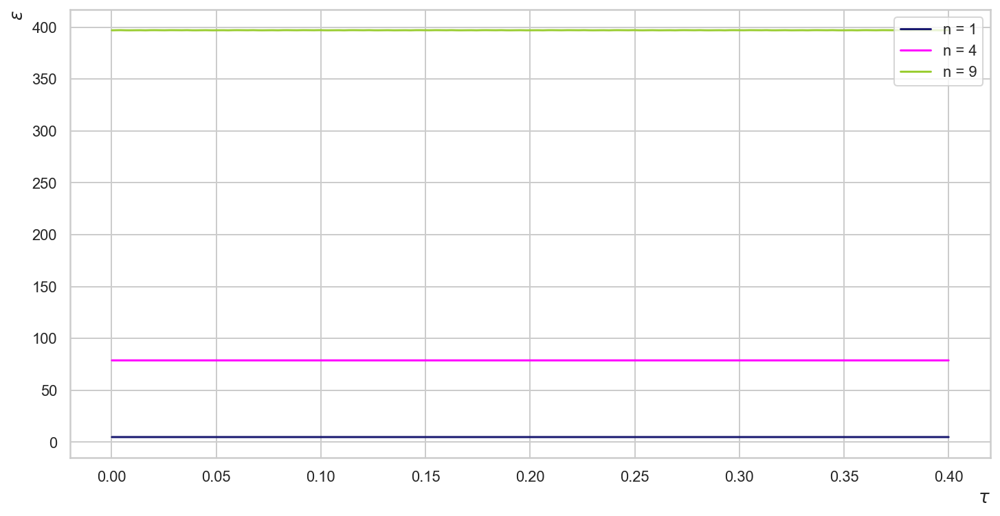

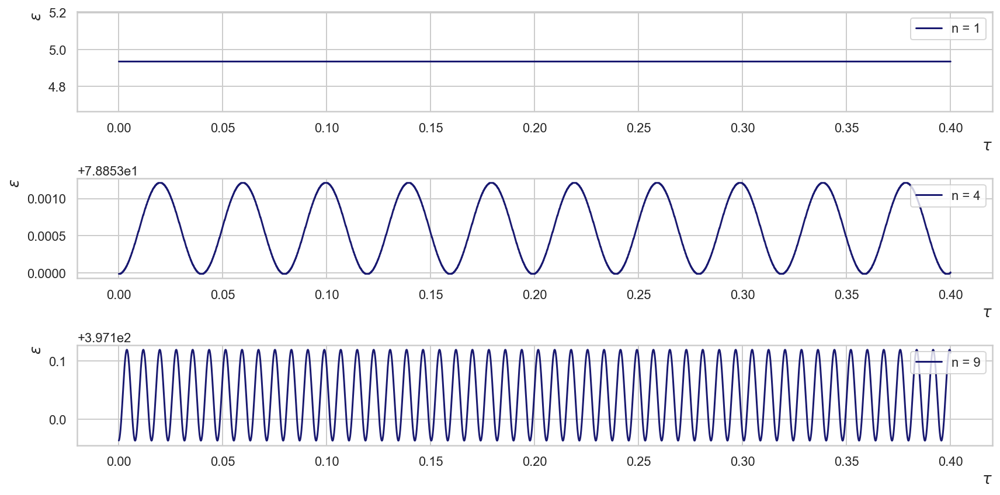

In [34]:
df1_1 = pd.read_csv("out/out_1_n1.txt", sep='\t', header=0, index_col=False)
df1_4 = pd.read_csv("out/out_1_n4.txt", sep='\t', header=0, index_col=False)
df1_9 = pd.read_csv("out/out_1_n9.txt", sep='\t', header=0, index_col=False)
dataframes = [df1_1, df1_4, df1_9]

fig = plt.figure(figsize = (12, 6))
plt.plot(df1_1['t'], df1_1['N'], label = 'n = 1')
plt.plot(df1_4['t'], df1_4['N'], label = 'n = 4')
plt.plot(df1_9['t'], df1_9['N'], label = 'n = 9')
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel('N', fontsize=13, loc='top')
_ = plt.legend(loc = 'upper right')
plt.savefig("./fig/testN.pdf")

fig = plt.figure(figsize = (12, 6))
plt.plot(df1_1['t'], df1_1['x'], label = 'n = 1')
plt.plot(df1_4['t'], df1_4['x'], label = 'n = 4')
plt.plot(df1_9['t'], df1_9['x'], label = 'n = 9')
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel('x', fontsize=13, loc='top')
_ = plt.legend(loc = 'upper right')
plt.savefig("./fig/testx.pdf")

fig = plt.figure(figsize = (12, 6))
plt.plot(df1_1['t'], df1_1['E'], label = 'n = 1')
plt.plot(df1_4['t'], df1_4['E'], label = 'n = 4')
plt.plot(df1_9['t'], df1_9['E'], label = 'n = 9')
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel(r'$\epsilon$', fontsize=13, loc='top')
_ = plt.legend(loc = 'upper right')
plt.savefig("./fig/testE.pdf")


fig = plt.figure(figsize = (12, 6))
plt.subplot(3, 1, 1)
plt.plot(df1_1['t'], df1_1['E'], label = 'n = 1')
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel(r'$\epsilon$', fontsize=13, loc='top')
plt.legend(loc = 'upper right')
plt.subplot(3, 1, 2)
plt.plot(df1_4['t'], df1_4['E'], label = 'n = 4')
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel(r'$\epsilon$', fontsize=13, loc='top')
plt.legend(loc = 'upper right')
plt.subplot(3, 1, 3)
plt.plot(df1_9['t'], df1_9['E'], label = 'n = 9')
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel(r'$\epsilon$', fontsize=13, loc='top')
plt.legend(loc = 'upper right')
fig.tight_layout()
plt.savefig("./fig/testE3.pdf")


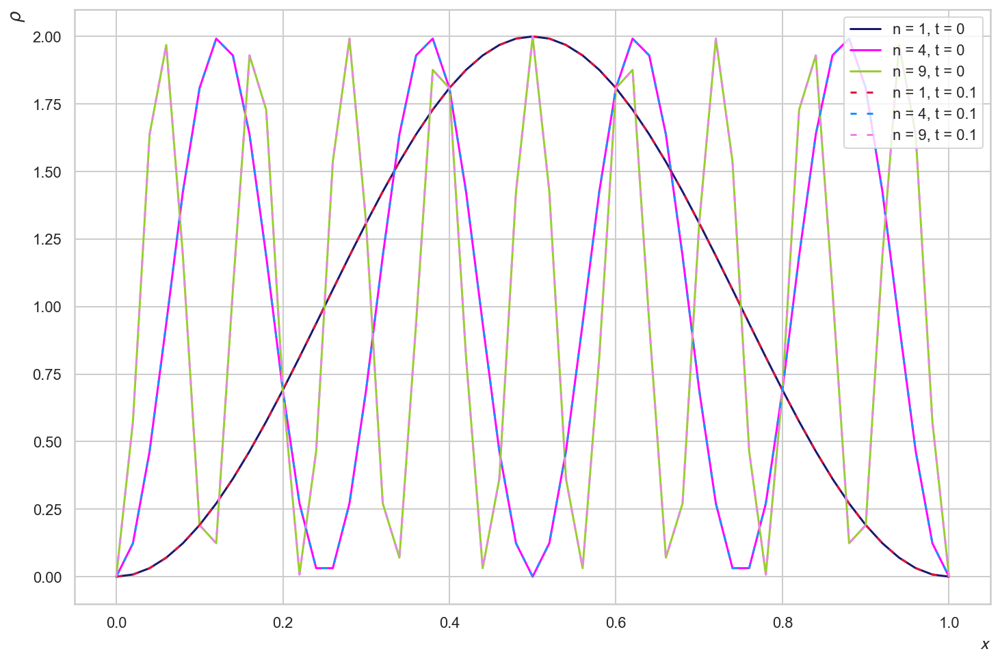

In [35]:
rho_01 = np.loadtxt('out/rho_1_n1.dat')
rho_04 = np.loadtxt('out/rho_1_n4.dat')
rho_09 = np.loadtxt('out/rho_1_n9.dat')


fig = plt.figure(figsize = (12, 8))
plt.plot(np.linspace(0, 1, 51), rho_01[51*0:51*1], label = 'n = 1, t = 0')
plt.plot(np.linspace(0, 1, 51), rho_04[51*0:51*1], label = 'n = 4, t = 0')
plt.plot(np.linspace(0, 1, 51), rho_09[51*0:51*1], label = 'n = 9, t = 0')
plt.plot(np.linspace(0, 1, 51), rho_01[51*1000:51*1001], label = 'n = 1, t = 0.1', ls = '--', dashes=(3, 5))
plt.plot(np.linspace(0, 1, 51), rho_04[51*1000:51*1001], label = 'n = 4, t = 0.1', ls = '--', dashes=(3, 5))
plt.plot(np.linspace(0, 1, 51), rho_09[51*1000:51*1001], label = 'n = 9, t = 0.1', ls = '--', dashes=(3, 5))
plt.xlabel(r'$\mathcal{x}$', fontsize=13, loc='right')
plt.ylabel(r'$\rho$', fontsize=13, loc='top')
_ = plt.legend(loc = 'upper right')
plt.savefig("./fig/testRho.pdf")

Algorytm działa zgodnie z przewidywaniami. Norma i położenie średnie są stałe przy wyłączonym polu oscylującym (fluktuacje od 4. miejsca po przecinku). 
Gęstość prawdopodobieństwa jest stała w czasie.

# 3. Symuacje z włączonym polem oscylującym - przejścia rezonansowe

In [5]:
def load_data_3(n, k):
    d = {}
    for omega in [3, 5, 7, 8, 9, 11]:
         d[omega] = pd.read_csv("./out/out_2_{}pi_n{}_k{}.txt".format(omega, n, k), sep='\t', header=0, index_col=False)
    return d

In [6]:
def plot_data(data, n, k):
    fig = plt.figure(figsize = (14,8))
    i = 1
    for key in data.keys():
        plt.subplot(2,3 , i)
        plt.plot(data[key]['t'], data[key]['E'])
        plt.xlabel(r'$\tau$', fontsize=13, loc='right')
        plt.ylabel(r'$\epsilon$', fontsize=13, loc='top')
        plt.title(r'n = {}, $\omega$ = {}$\pi^2/2$, k = {}'.format(n, key, k))
        i+=1
    fig.tight_layout()       

In [7]:
data3_n1_k1 = load_data_3(1, 1)
data3_n1_k5 = load_data_3(1, 5)
data3_n1_k10 = load_data_3(1, 10)
data3_n4_k1 = load_data_3(4, 1)
data3_n4_k5 = load_data_3(4, 5)
data3_n4_k10 = load_data_3(4, 10)
data3_n9_k1 = load_data_3(9, 1)
data3_n9_k10 = load_data_3(9, 10)

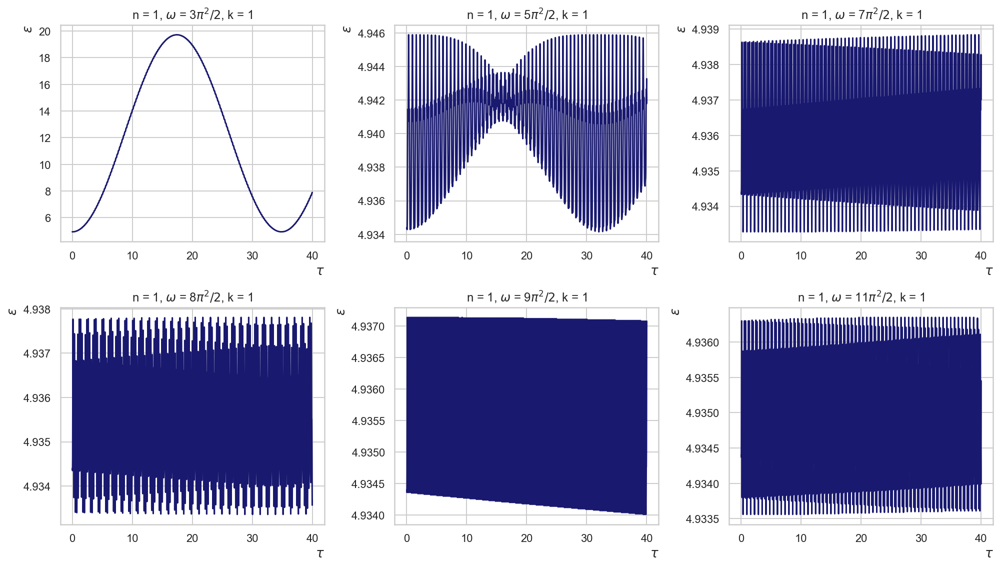

In [8]:
plot_data(data3_n1_k1, 1, 1)

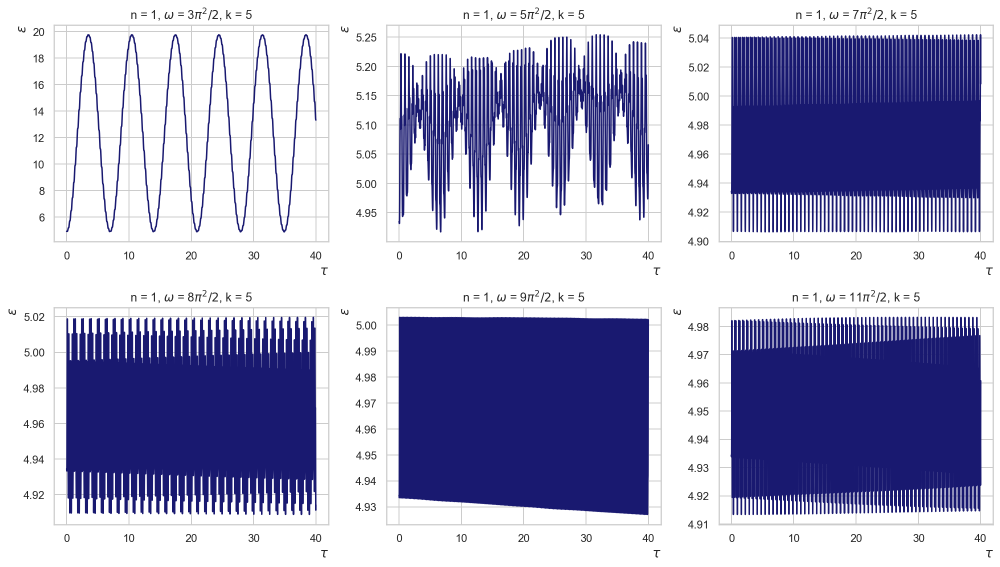

In [9]:
plot_data(data3_n1_k5, 1, 5)

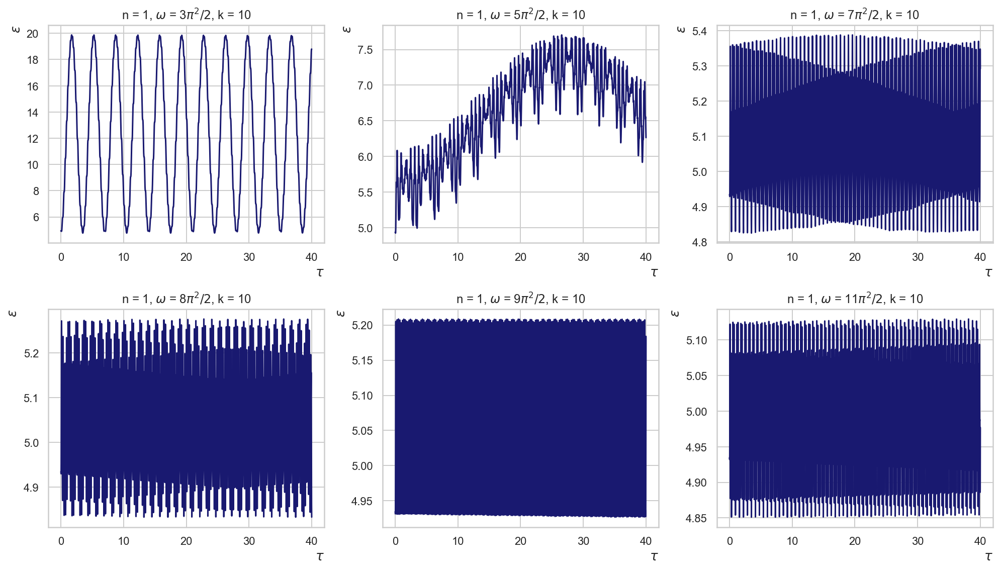

In [10]:
plot_data(data3_n1_k10, 1, 10)

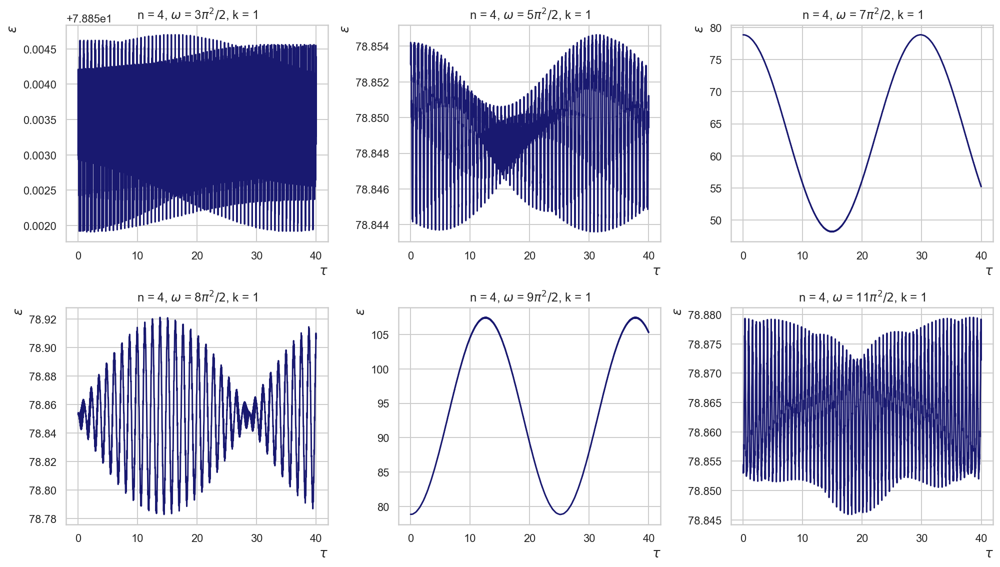

In [11]:
plot_data(data3_n4_k1, 4, 1)

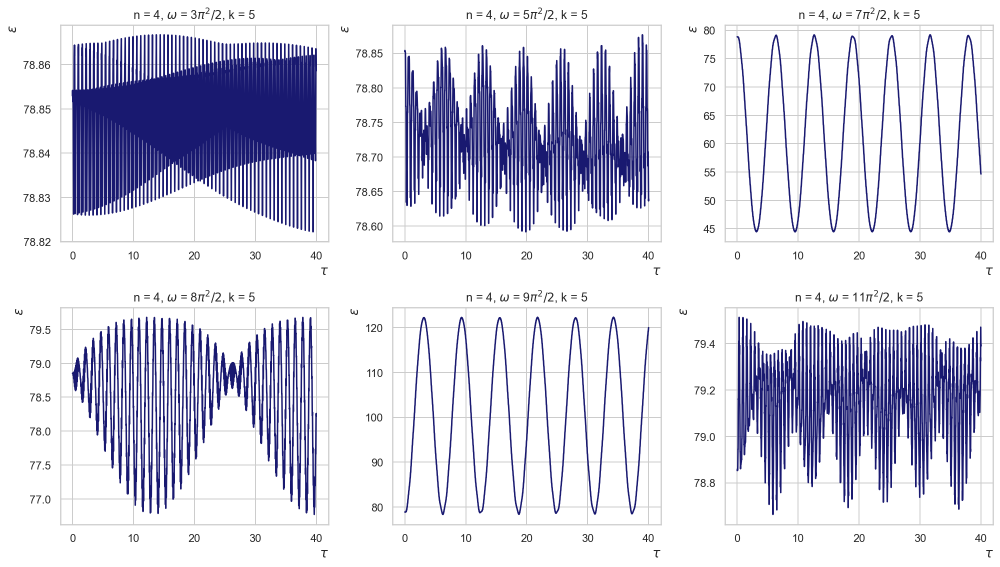

In [12]:
plot_data(data3_n4_k5, 4, 5)

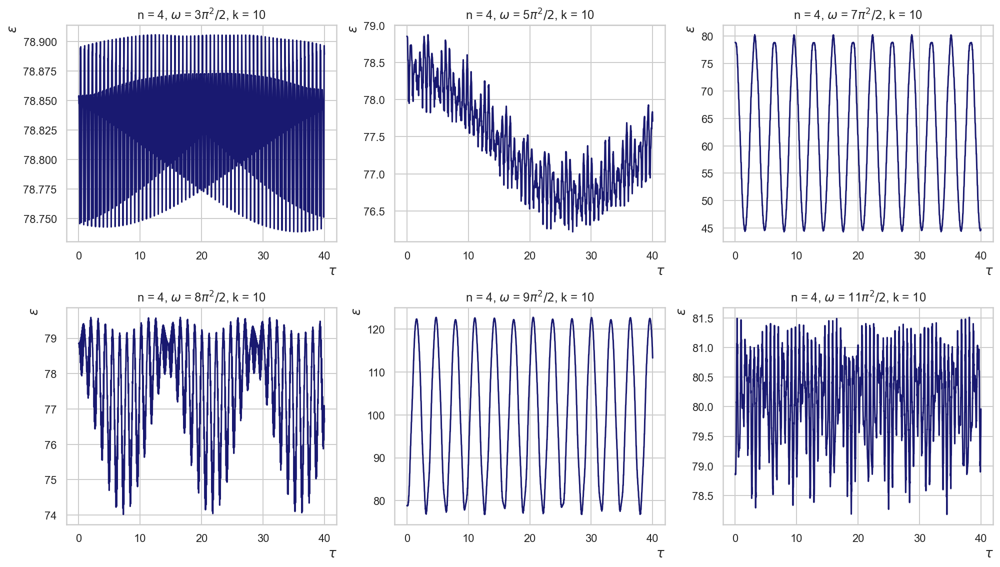

In [13]:
plot_data(data3_n4_k10, 4, 10)

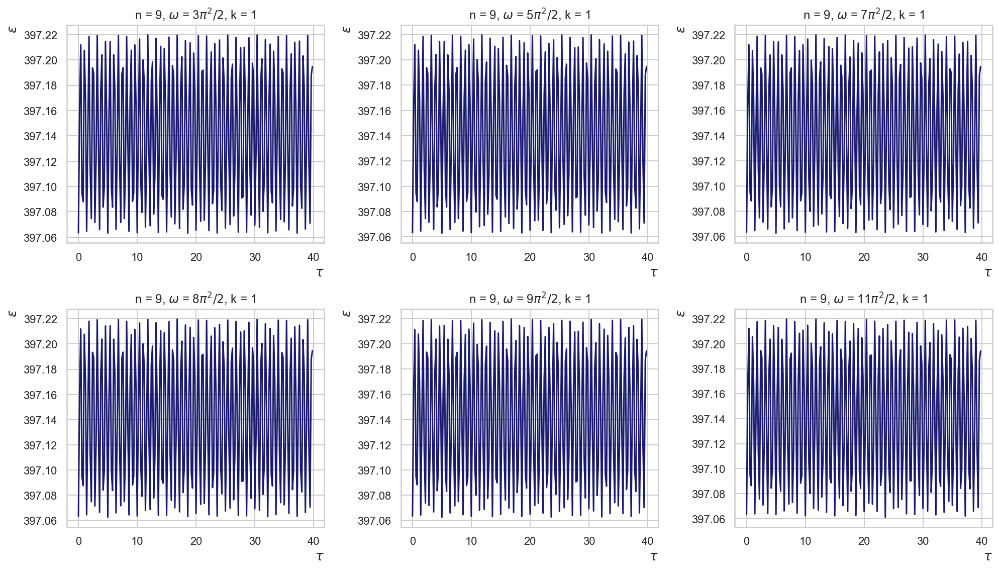

In [14]:
plot_data(data3_n9_k1, 9, 1)

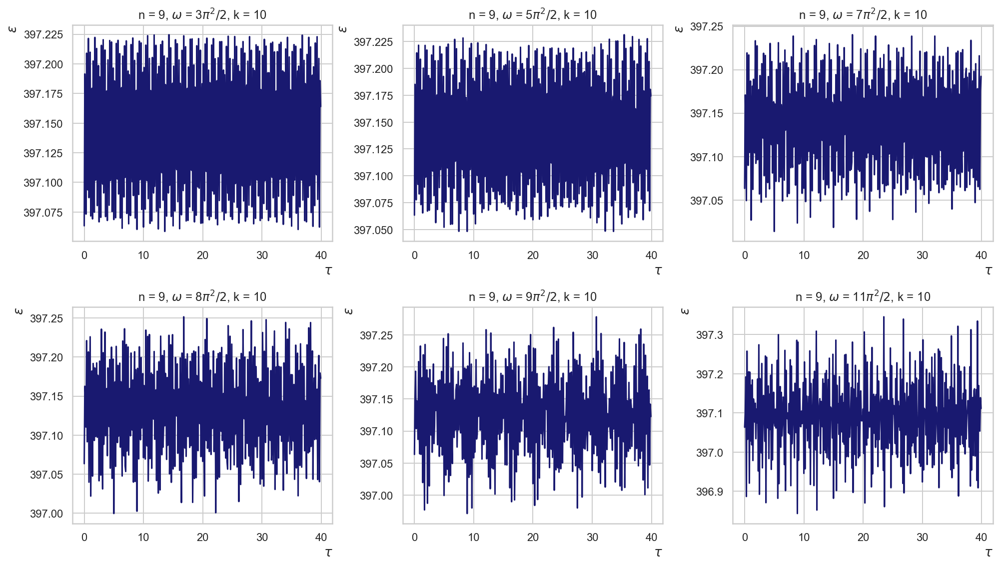

In [15]:
plot_data(data3_n9_k10, 9, 10)

Dla stanu podstawowego n = 9 nie zaobserwowano przejść rezonansowych dla badanych częstości. 

Dla n = 4 przejścia rezonansowe wystąpiły przy $\omega \in \{7\pi^2/2, 9\pi^2/2\}$.

Dla n = 1 przejścia rezonansowe wystąpiły przy $\omega \in \{3\pi^2/2\}$.

$3\pi^2/2 $ przejście 2->1

$7\pi^2/2 $ przejście 4->3

$9\pi^2/2 $ przejście 5->4

In [55]:
rho_3pi = np.loadtxt("out/rho_2_3pi.dat")
rho_rez = np.loadtxt('out/rho_4_9pi_n4.dat')
rho_rezb = np.loadtxt('out/rho_2_9pi_n4_k5.dat')
rho_nrez = np.loadtxt('out/rho_2_8pi_n4.dat')
rho_test = np.loadtxt('./test_rez2.dat')
rho_test2 = np.loadtxt('./test_rez3.dat')

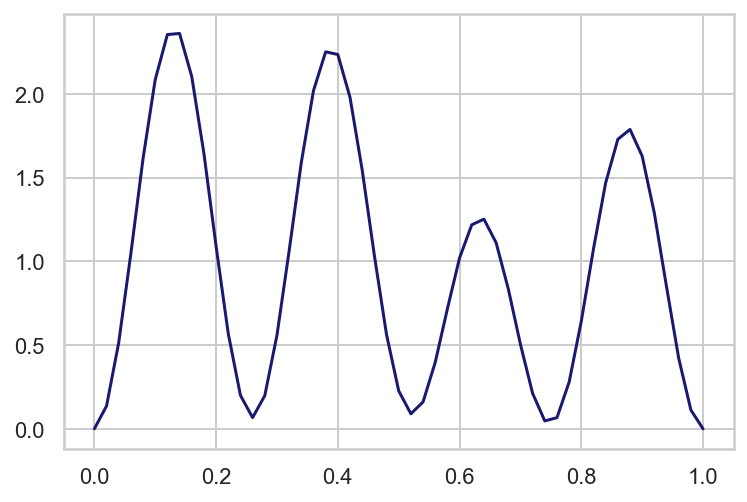

In [70]:
i = 780
idx0 = 51*i
idx1 = 51*(i+1)
plt.plot(np.linspace(0, 1, 51), rho_test2[idx0:idx1])

Animation size has reached 20984757 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


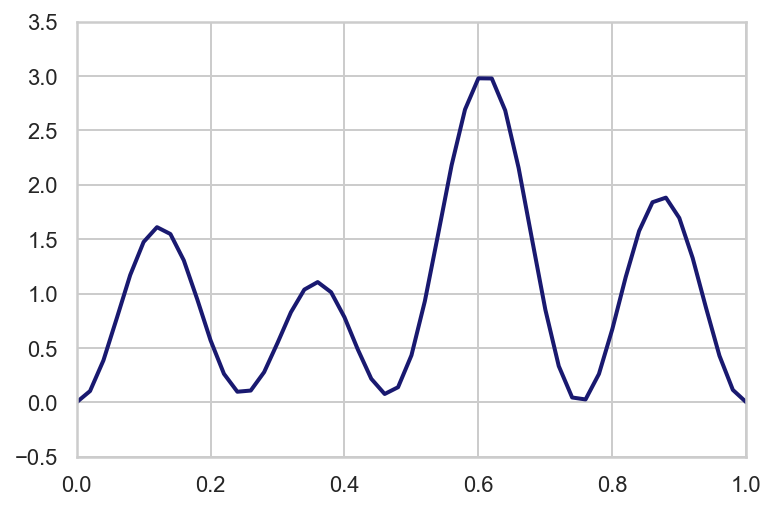

In [48]:
ffig = plt.figure()
ax = plt.axes(xlim=(0, 1), ylim=(-0.5, 3.5))
line, = ax.plot([], [], lw=2)

def init():
    line.set_data([], [])
    return line,

def animate(i):
    x = np.linspace(0, 1, 51)
    y = rho_test2[51*i:51*(i+1)]
    line.set_data(x, y)
    return line,

anim = animation.FuncAnimation(ffig, animate, init_func=init,
                               frames=1000, interval=100, blit=True)
HTML(anim.to_jshtml())

# 4. Przykładowe wykresy dla częstości rezonansowej

Wykresy normy, śrendiego położenia, średniej energii oraz gęstości prawdopodobieństwa dla przejścia rezonansowego 5-->4 ( $\omega = 9\pi^2/2$) dla n = 4

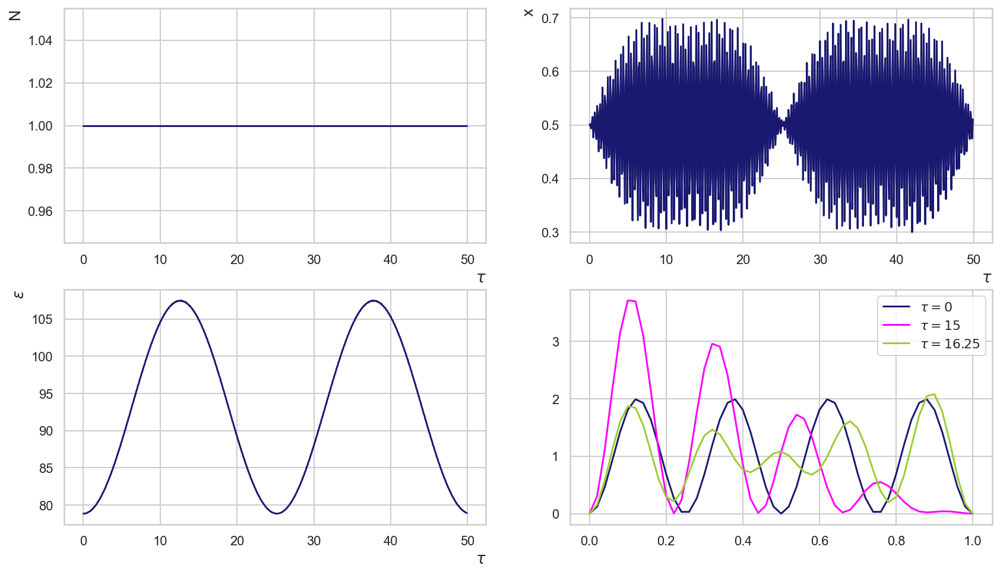

In [37]:
rho_rez = np.loadtxt('out/rho_4_9pi_n4.dat')
df4_4_4 = pd.read_csv("out/out_4_9pi_n4.txt", sep='\t', header=0, index_col=False)

fig = plt.figure(figsize=(14, 8))
plt.subplot(2,2,1)
plt.plot(df4_4_4['t'], round(df4_4_4['N'], 4))
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel('N', fontsize=13, loc='top')
plt.subplot(2,2,2)
plt.plot(df4_4_4['t'], round(df4_4_4['x'], 4))
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel('x', fontsize=13, loc='top')
plt.subplot(2,2,3)
plt.plot(df4_4_4['t'], round(df4_4_4['E'], 4))
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel(r'$\epsilon$', fontsize=13, loc='top')
plt.subplot(2,2,4)
plt.plot(np.linspace(0, 1, 51), rho_rez[0*51:1*51], label = r'$\tau = 0$')
plt.plot(np.linspace(0, 1, 51), rho_rez[300*51:301*51], label = r'$\tau = 15$')
plt.plot(np.linspace(0, 1, 51), rho_rez[325*51:326*51], label = r'$\tau = 16.25$')
_ = plt.legend()
plt.savefig("./fig/rezonans.pdf")

Dla przejść rezonansowych obserwujemy zmianę gęstości prawdopodobieństwa w czasie. W przypadku stanu podstawowego n = 4 funkcja czteromodowa przechodzi w funkcję pięciomodową (analogicznie dla n = 1 funkcja jednomodowa przechodzi w funkcję dwumodową). 

# 5. Przykładowe wykresy dla częstości nierezonansowej

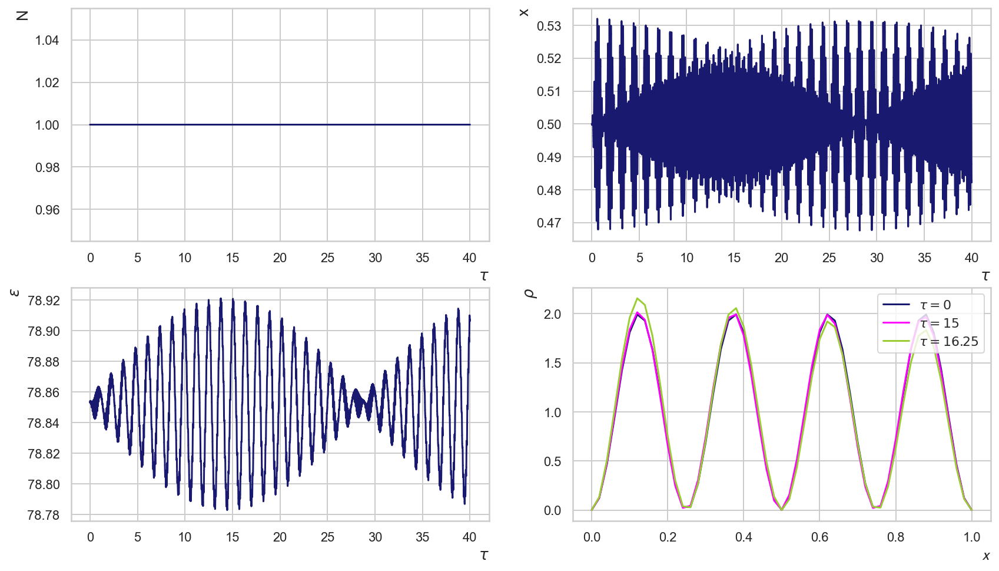

In [39]:
rho_nrez = np.loadtxt('out/rho_2_8pi_n4.dat')
df_nrez = pd.read_csv("out/out_2_8pi_n4.txt", sep='\t', header=0, index_col=False)


fig = plt.figure(figsize=(14, 8))
plt.subplot(2,2,1)
plt.plot(df_nrez['t'], round(df_nrez['N'], 4))
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel('N', fontsize=13, loc='top')
plt.subplot(2,2,2)
plt.plot(df_nrez['t'], round(df_nrez['x'], 4))
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel('x', fontsize=13, loc='top')
plt.subplot(2,2,3)
plt.plot(df_nrez['t'], round(df_nrez['E'], 4))
plt.xlabel(r'$\tau$', fontsize=13, loc='right')
plt.ylabel(r'$\epsilon$', fontsize=13, loc='top')
plt.subplot(2,2,4)
plt.plot(np.linspace(0, 1, 51), rho_nrez[0*51:1*51], label = r'$\tau = 0$')
plt.plot(np.linspace(0, 1, 51), rho_nrez[300*51:301*51], label = r'$\tau = 15$')
plt.plot(np.linspace(0, 1, 51), rho_nrez[325*51:326*51], label = r'$\tau = 16.25$')
plt.xlabel(r'$\mathcal{x}$', fontsize=13, loc='right')
plt.ylabel(r'$\rho$', fontsize=13, loc='top')
_ = plt.legend(loc = 'upper right')
plt.savefig("./fig/nie_rezonans.pdf")

W przypadku braku rezonansu funkcja ęstości prawdopodobieństwa nie zmienia swojego kształtu (obserwowane są nieznaczne fluktuacje, lecz nie pojawiają się dodatkowe mody)

TODO: tabelka n(omega) 3x3 zaznaczać kiedy rezonansy a kiedy

# Badania okolicy rezonansu

In [21]:
def load_datasets(k):
    d = {}
    if k == 1:
        for i in ['09', '092', '094', '096', '098', '099', '0995' ,'1', '1005', '101', '102', '104', '106', '108', '11']:
            d[i] = pd.read_csv("./out/out_6_9pi_n4_{}.txt".format(i), sep='\t', header=0, index_col=False)
        return d
    elif k == 5:
        for i in ['09', '092', '094', '096', '098', '099', '0995' ,'1', '1005', '101', '102', '104', '106', '108', '11']:
            d[i] = pd.read_csv("./out/out_6_9pi_n4_{}_k5.txt".format(i), sep='\t', header=0, index_col=False)
        return d
    elif k == 10:
        for i in ['09', '092', '094', '096', '098', '099', '0995' ,'1', '1005', '101', '102', '104', '106', '108', '11']:
            d[i] = pd.read_csv("./out/out_6_9pi_n4_{}_k10.txt".format(i), sep='\t', header=0, index_col=False)
        return d

In [22]:
dfrez_n4_w9_k1 = load_datasets(1)
dfrez_n4_w9_k5 = load_datasets(5)
dfrez_n4_w9_k10 = load_datasets(10) 
dfrez_n4_w9_k5 = load_datasets(5)

In [23]:
def find_maxE(data):
    Emax = []
    for key in data.keys():
        max = data[key]['E'].max()
        Emax.append(max)
    return Emax

In [24]:
Emax_k1 = find_maxE(dfrez_n4_w9_k1)
Emax_k5 = find_maxE(dfrez_n4_w9_k5)
Emax_k10 = find_maxE(dfrez_n4_w9_k10)

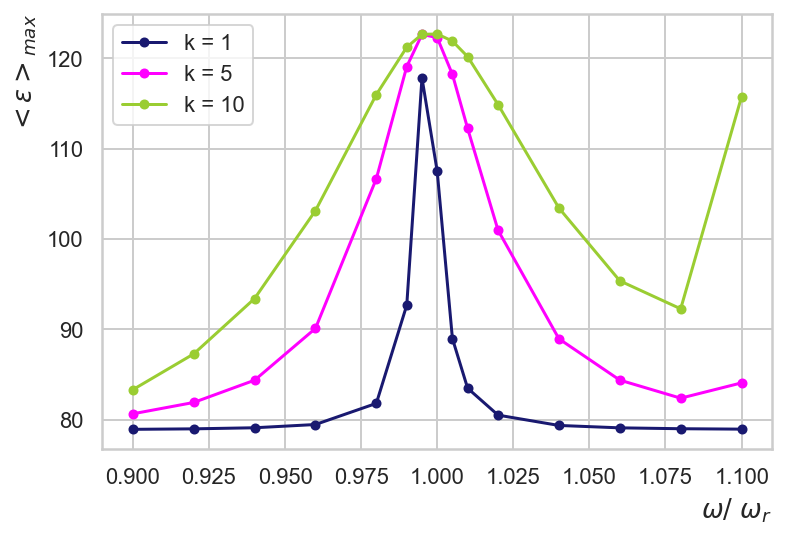

In [77]:
omega = [0.9, 0.92, 0.94, 0.96, 0.98, 0.99, 0.995, 1, 1.005, 1.01, 1.02, 1.04, 1.06, 1.08, 1.1]
plt.plot(omega, Emax_k1, 'o-', markersize = 4, label = 'k = 1')
plt.plot(omega, Emax_k5, 'o-', markersize = 4, label = 'k = 5')
plt.plot(omega, Emax_k10, 'o-', markersize = 4, label = 'k = 10')
plt.xlabel(r'$\omega /\ \omega_r$', fontsize=13, loc='right')
plt.ylabel(r'$<\epsilon>_{max}$', fontsize=13, loc='top')
_ = plt.legend()
plt.savefig("./fig/rezonans_okolice.pdf")

Wraz ze wzrostem k rośnie maksymalna średnia wartość energii, a krzywa rezonansowa staje się coraz szersza. 